**Assignment 1**

Sorting M&M chocolates

Project made by:


*   Tiago Fontinha - up201806754
*   Francisco Sousa - up201904937



The sorting center of a M&M factory retrieves visual data from the production line to
determine the type of chocolates produced. The factory uses a computer vision application
to automatically calculate some properties of the sample, namely:
• the distribution of each color in the sample, e.g., the number of red (or blue or ...)
chocolates. At the end, if the sample does not have chocolate of all colors, the system
must raise an alarm by printing “Color XPTO is missing”;
• identify the type of peanuts in the line, namely with or without peanut;
• the average shape area of all chocolates in millimeters and organized by color

Installation of Assets

In [44]:
!pip install gdown
import gdown
import zipfile
import os

zip_link = "https://drive.google.com/uc?export=download&id=1w3GdmU1wPqGuAzCUH7UbGNsUmM9-p-zl"
zip_path = "/content/CV_A1.zip"
extract_path = "/content/CV_Assignment/assign1"


gdown.download(zip_link, zip_path, quiet=False)


with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)


os.remove(zip_path)


extracted_files = os.listdir(extract_path)
print("Extracted Files:")
for file in extracted_files:
    print(file)


Downloading...
From: https://drive.google.com/uc?export=download&id=1w3GdmU1wPqGuAzCUH7UbGNsUmM9-p-zl
To: /content/CV_A1.zip
100%|██████████| 15.4M/15.4M [00:00<00:00, 220MB/s]


Extracted Files:
CV_Assignment


1.** Calibrate the intrinsic parameters and lens distortion of the camera. Show the intrinsic
matrix, the lens distortion coefficients and the re-projection error.**


This code performs camera calibration using images of a checkerboard pattern. The checkerboard's known geometry provides reference points for the calibration process, where each corner of the squares is detected in the images. Detected corners are refined using an iterative method to improve accuracy. Once sufficient points are gathered from multiple images, the camera's intrinsic matrix (focal length, optical center) and lens distortion coefficients are computed. The accuracy of the calibration is evaluated by calculating the re-projection error, which compares the projected points to the actual detected corners.

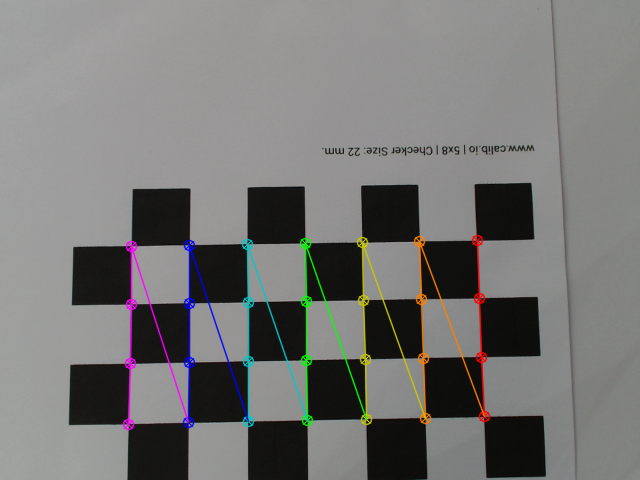

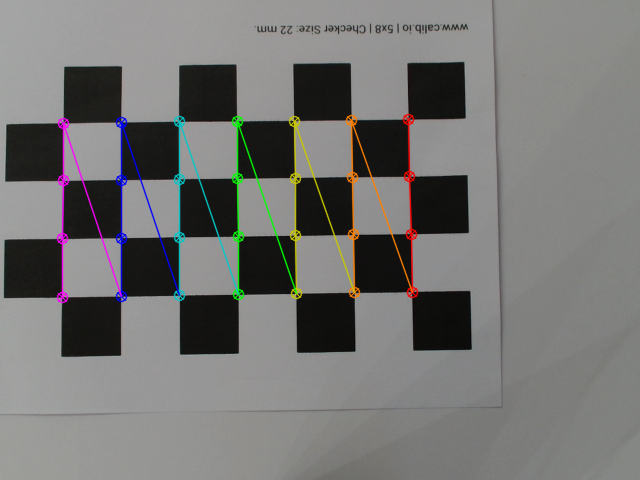

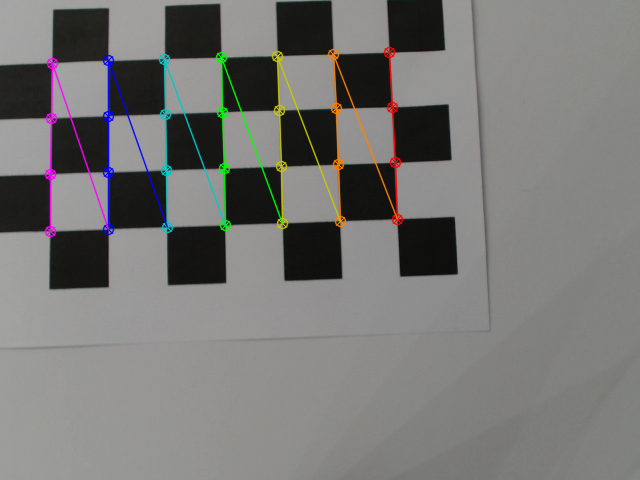

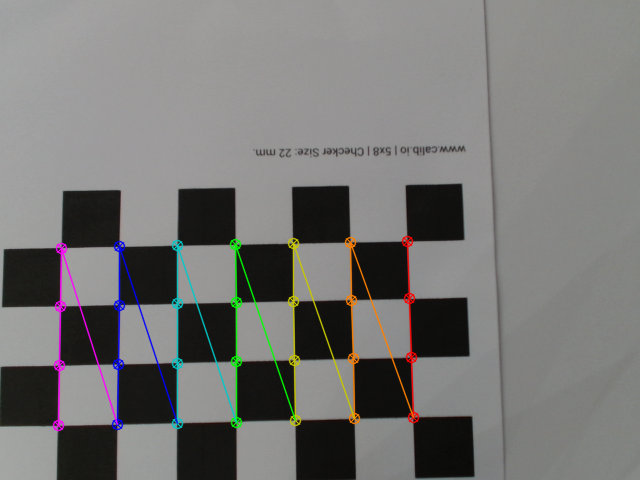

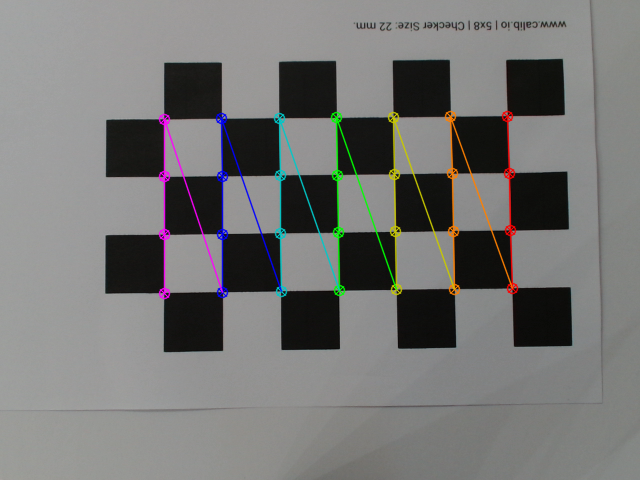

...

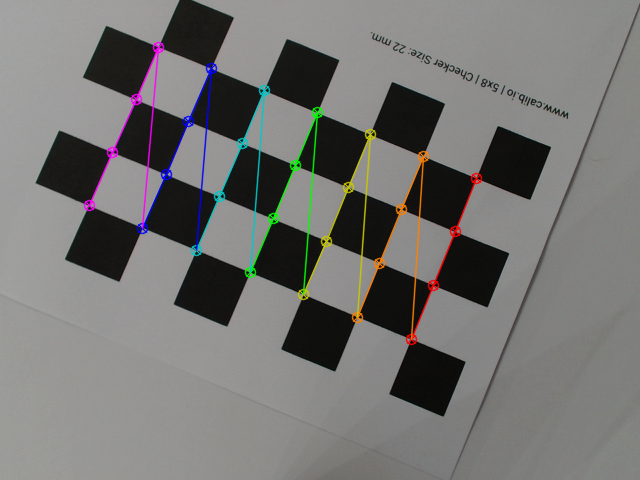

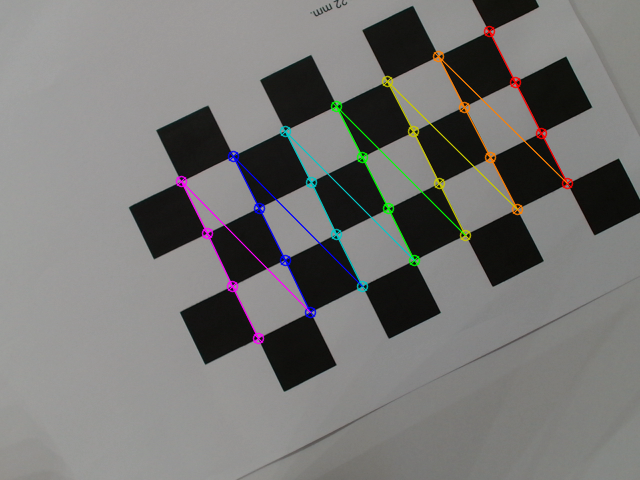

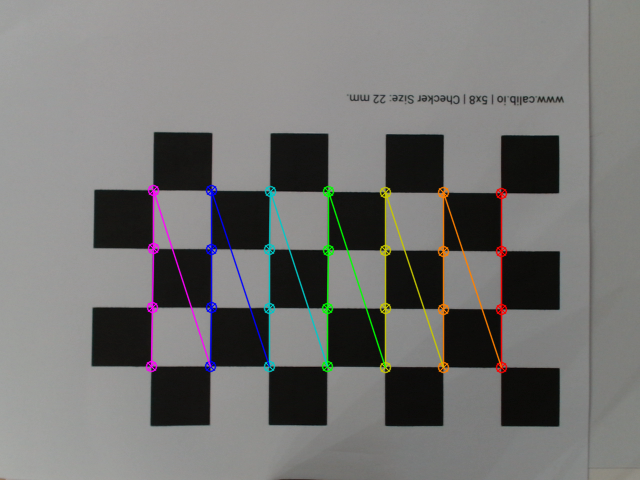

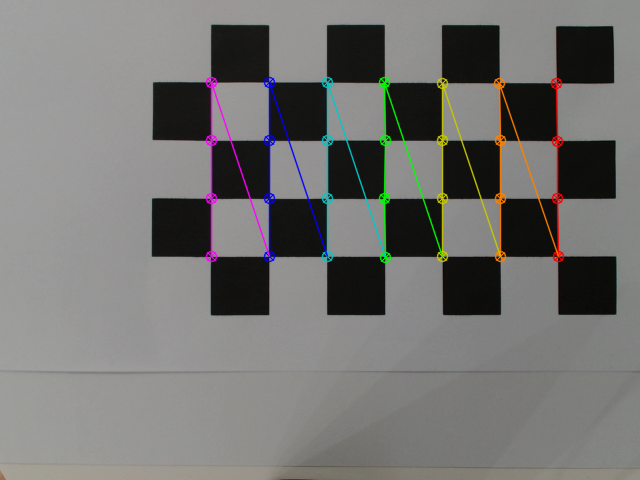

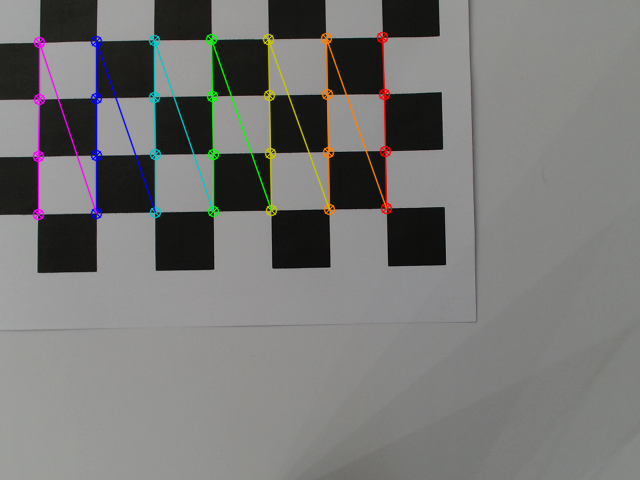

Intrinsic Matrix:
 [[423.89541836   0.         334.10055716]
 [  0.         425.98332374 273.14126288]
 [  0.           0.           1.        ]]
Lens Distortion Coefficients:
 [[ 0.01239866 -0.03238729 -0.00023101 -0.0013372   0.01323904]]
Re-projection Error:  0.05813955403546852


In [45]:
import cv2
import numpy as np
import glob
from google.colab.patches import cv2_imshow


checkerboard_size = (4, 7)
square_size = 22 # 22 mm

objp = np.zeros((checkerboard_size[0] * checkerboard_size[1], 3), np.float32)
objp[:, :2] = np.mgrid[0:checkerboard_size[0], 0:checkerboard_size[1]].T.reshape(-1, 2)
objp *= square_size

objpoints = []
imgpoints = []


images = glob.glob('./CV_Assignment/assign1/CV_Assignment/assign1/calib/calib_*.png')

for fname in images:
    img = cv2.imread(fname)
    if img is None:
        print(f"Error: Unable to load image {fname}.")
        continue

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.equalizeHist(gray)
    ret, corners = cv2.findChessboardCorners(gray, checkerboard_size, cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_NORMALIZE_IMAGE + cv2.CALIB_CB_FAST_CHECK)

    if ret:
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
        corners = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1), criteria)

        objpoints.append(objp)
        imgpoints.append(corners)
        cv2.drawChessboardCorners(img, checkerboard_size, corners, ret)
        cv2_imshow(img)
    else:
        print(f"Chessboard corners not detected for image: {fname}")

if len(objpoints) > 0:
    ret, intrinsic_matrix, dist_coeffs, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    total_error = 0
    for i in range(len(objpoints)):
        imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], intrinsic_matrix, dist_coeffs)
        error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2) / len(imgpoints2)
        total_error += error

    mean_error = total_error / len(objpoints)


    print("Intrinsic Matrix:\n", intrinsic_matrix)
    print("Lens Distortion Coefficients:\n", dist_coeffs)
    print("Re-projection Error: ", mean_error)
else:
    print("Insufficient calibration data: Could not find any valid chessboard corners.")


2. **Calibrate the extrinsic parameters of the camera setup (or instead, use the extrinsic
image to manually measure the dimensions of a black square of the chessboard in
pixels. In this way, you will know the conversion between pixel to millimeter). Show
the extrinsic matrix (rotation, translation, etc) and/or the conversion ratio between
pixel to millimeter that was used.**


This code performs two tasks: camera calibration using a checkerboard and ruler length estimation using edge detection and line detection. For camera calibration, it detects chessboard corners, refines them, and uses them to compute the camera's intrinsic parameters and lens distortion coefficients. It also calculates the conversion ratio between pixels and millimeters based on the known size of the chessboard squares. For ruler length estimation, the code detects edges, finds the longest line using the Hough Line Transform, and calculates the pixel-to-millimeter ratio by comparing the detected line to the actual ruler length. Finally, it visualizes the detected lines and provides the conversion ratio for further use.

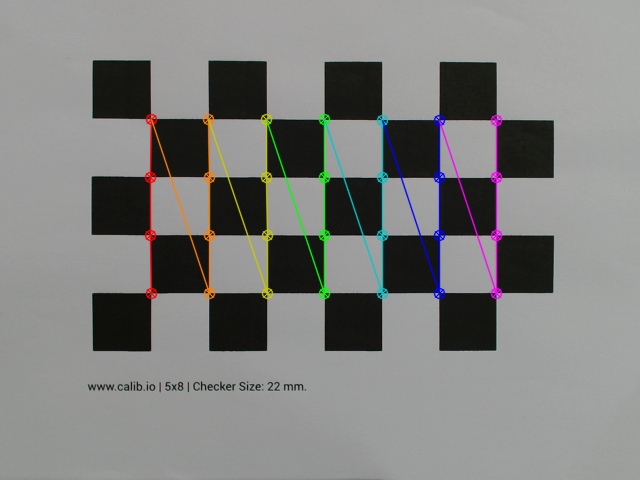

Intrinsic Matrix:
 [[2.20831076e+03 0.00000000e+00 3.71850387e+02]
 [0.00000000e+00 2.21878607e+03 2.47950869e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Lens Distortion Coefficients:
 [[ 4.47451433e-01  2.01246633e+01 -9.55135853e-03 -8.80149690e-03
  -2.85415430e+03]]
Extrinsic Parameters for Image 1:
Rotation Matrix:
 [[ 3.41080320e-04  9.99476618e-01 -3.23476992e-02]
 [-9.99999143e-01  3.81781046e-04  1.25205816e-03]
 [ 1.26375260e-03  3.23472445e-02  9.99475892e-01]]
Translation Vector:
 [[-84.21630711]
 [ 17.04859109]
 [845.60431213]]
Conversion Ratio between Pixels and Millimeters: 0.3792 mm/pixel


In [46]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

chessboard_size = (4, 7)
square_size_mm = 22

objp = np.zeros((chessboard_size[0] * chessboard_size[1], 3), np.float32)
objp[:, :2] = np.mgrid[0:chessboard_size[0], 0:chessboard_size[1]].T.reshape(-1, 2) * square_size_mm

objpoints = []
imgpoints = []

image_path = "./CV_Assignment/assign1/CV_Assignment/assign1/data/chess.png"
chessboard_image = cv2.imread(image_path)
gray = cv2.cvtColor(chessboard_image, cv2.COLOR_BGR2GRAY)

ret, corners = cv2.findChessboardCorners(gray, chessboard_size, None)

if ret:
    objpoints.append(objp)
    corners_refined = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1),
                                       criteria=(cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001))
    imgpoints.append(corners_refined)

    cv2.drawChessboardCorners(chessboard_image, chessboard_size, corners_refined, ret)
    cv2_imshow(chessboard_image)

    if len(objpoints) > 0:
        ret, intrinsic_matrix, dist_coeffs, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

        if ret:
            print("Intrinsic Matrix:\n", intrinsic_matrix)
            print("Lens Distortion Coefficients:\n", dist_coeffs)

            for i in range(len(rvecs)):
                rotation_matrix, _ = cv2.Rodrigues(rvecs[i])
                translation_vector = tvecs[i]

                print(f"Extrinsic Parameters for Image {i + 1}:")
                print("Rotation Matrix:\n", rotation_matrix)
                print("Translation Vector:\n", translation_vector)

            sample_image_index = 0
            square_points_3d = objpoints[sample_image_index]

            imgpoints_projected, _ = cv2.projectPoints(square_points_3d, rvecs[sample_image_index], tvecs[sample_image_index], intrinsic_matrix, dist_coeffs)

            point_3d_1 = square_points_3d[0]
            point_3d_2 = square_points_3d[1]
            dist_mm = np.linalg.norm(point_3d_2 - point_3d_1)

            point_2d_1 = imgpoints_projected[0][0]
            point_2d_2 = imgpoints_projected[1][0]
            dist_pixels = np.linalg.norm(point_2d_2 - point_2d_1)

            conversion_ratio = dist_mm / dist_pixels
            print(f"Conversion Ratio between Pixels and Millimeters: {conversion_ratio:.4f} mm/pixel")
        else:
            print("Calibration failed, please check your input images.")
    else:
        print("Insufficient calibration data: Could not find any valid chessboard corners.")
else:
    print("Chessboard corners not found in the image.")

def undistort(img):
    h, w = img.shape[:2]
    new_camera_matrix, roi = cv2.getOptimalNewCameraMatrix(intrinsic_matrix, dist_coeffs, (w, h), 1, (w, h))
    undistorted_img = cv2.undistort(img, intrinsic_matrix, dist_coeffs, None, new_camera_matrix)

    x, y, w, h = roi
    undistorted_img = undistorted_img[y:y+h, x:x+w]

    return undistorted_img


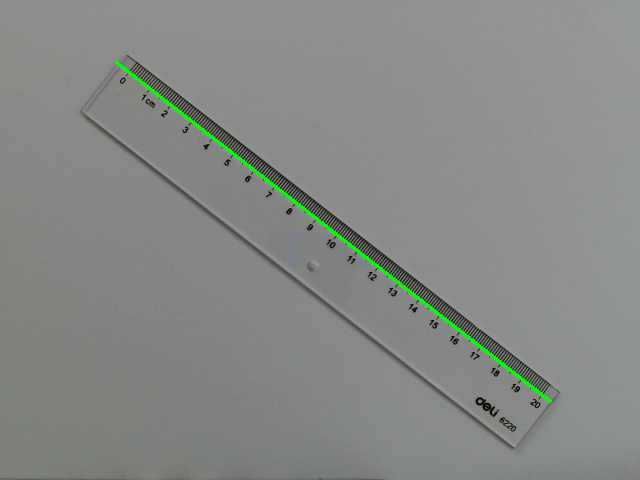

Pixel Distance: 550.71 pixels
Pixel to Millimeter Conversion Ratio: 0.3792 mm/pixel


In [47]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow


image_path = './CV_Assignment/assign1/CV_Assignment/assign1/data/ruler.png'
ruler_image = cv2.imread(image_path)

gray = cv2.cvtColor(ruler_image, cv2.COLOR_BGR2GRAY)


edges = cv2.Canny(gray, 50, 150)

lines = cv2.HoughLinesP(edges, rho=1, theta=np.pi/180, threshold=100, minLineLength=100, maxLineGap=10)


if lines is not None:
    # sort the detected lines by their length (from longest to shortest)
    lines = sorted(lines, key=lambda x: np.linalg.norm(x[0][:2] - x[0][2:]), reverse=True)

    # use the longest line detected (which we assume to be the full length of the ruler)
    longest_line = lines[0][0]  # The format is [x1, y1, x2, y2]
    x1, y1, x2, y2 = longest_line

    # draw the longest line for visualization
    ruler_with_lines = ruler_image.copy()
    cv2.line(ruler_with_lines, (x1, y1), (x2, y2), (0, 255, 0), 2)

    # display the image with the detected longest line
    cv2_imshow(ruler_with_lines)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

    # calculate the pixel distance between the start and end points of the longest line
    point1 = np.array([x1, y1])
    point2 = np.array([x2, y2])
    pixel_distance = np.linalg.norm(point1 - point2)

    # aproximar o resto do comprimento da régua a 8.82 mm
    ruler_length_in_mm = 208.82
    pixel_to_mm_ratio = ruler_length_in_mm / pixel_distance


    print(f"Pixel Distance: {pixel_distance:.2f} pixels")
    print(f"Pixel to Millimeter Conversion Ratio: {pixel_to_mm_ratio:.4f} mm/pixel")
else:
    print("No lines were detected in the image.")

3. **Consider only the images with the isolated M&Ms retrieved from a white background. Implement the functions described below.**

(a) Define a ROI (region of interest) for the image

(b) Show a histogram for each image of M&Ms considering HSV.


This code processes images to analyze color distributions and detect contours of objects (M&Ms). First, the image is converted to the HSV color space, and histograms are generated for the Hue, Saturation, and Value channels to understand the color distribution. Afterward, the image is converted to grayscale, blurred, and edges are detected using the Canny edge detector. Contours are identified from the edges, and a bounding rectangle is drawn around the objects of interest. The result is displayed with the bounding box drawn around the detected M&Ms.

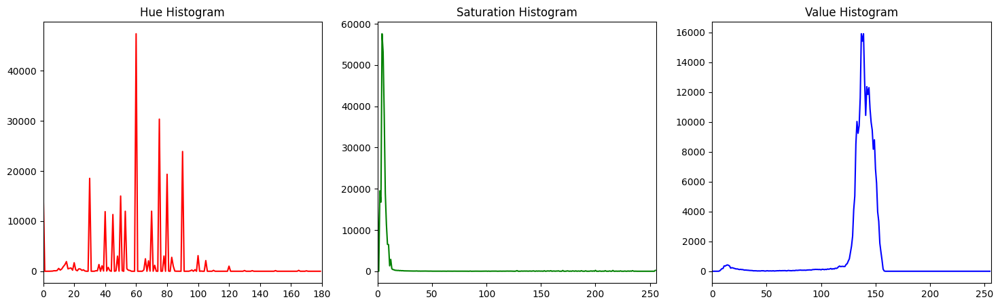

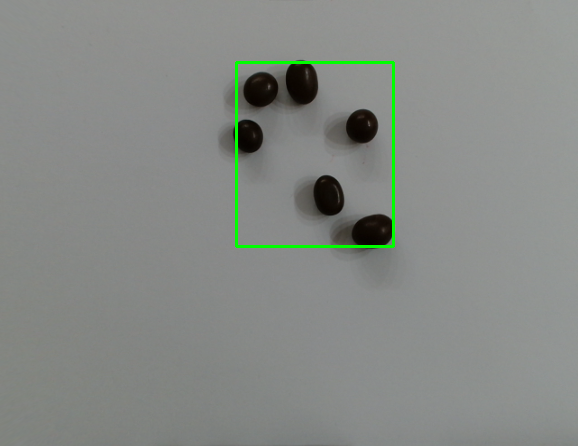

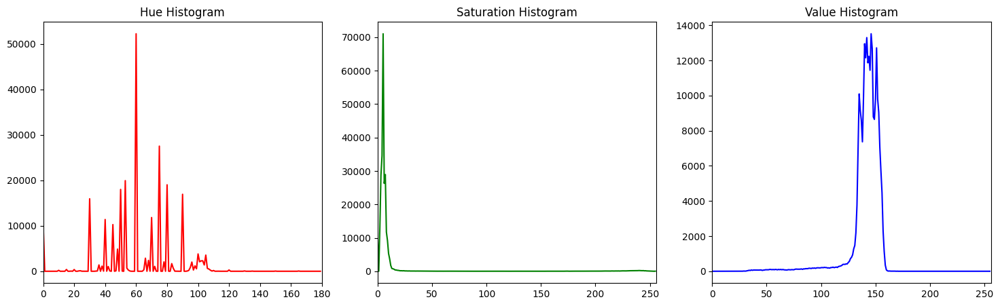

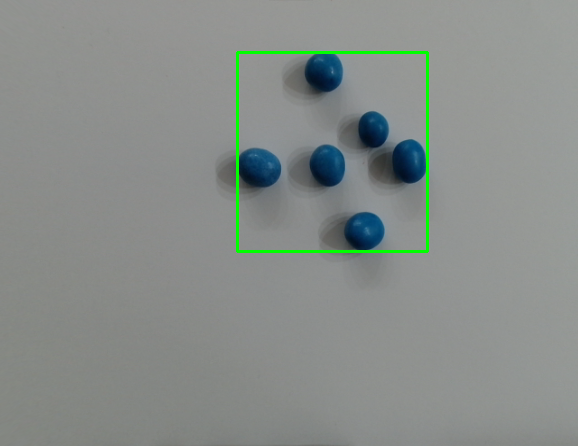

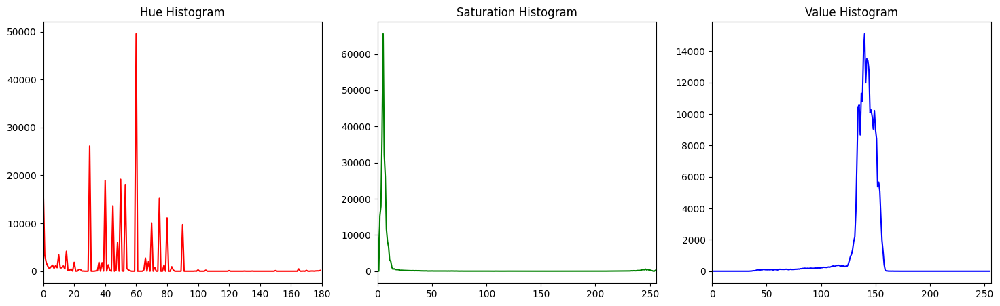

...

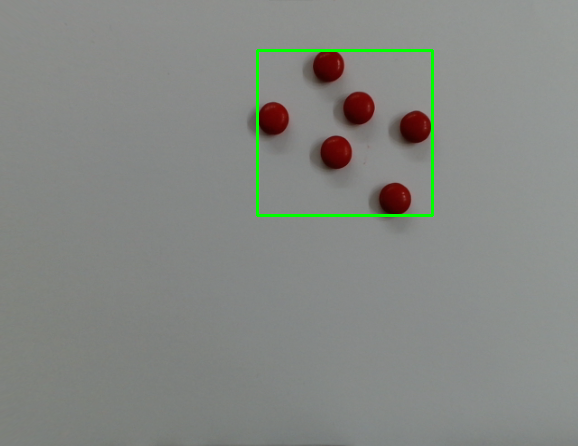

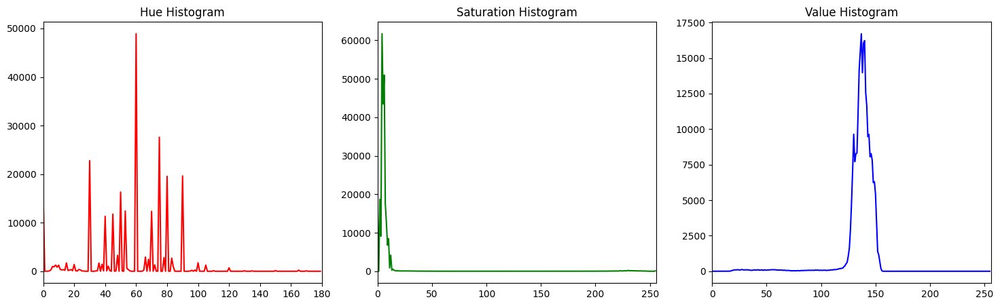

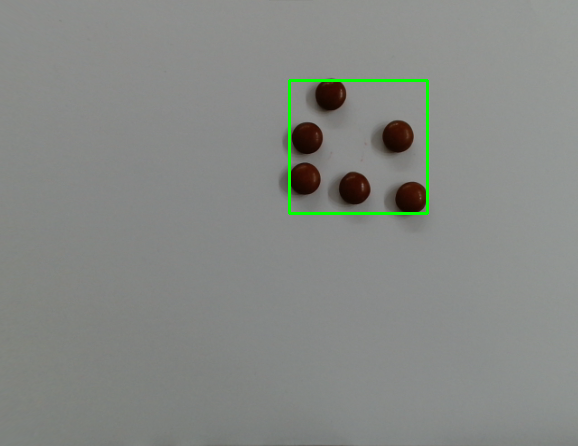

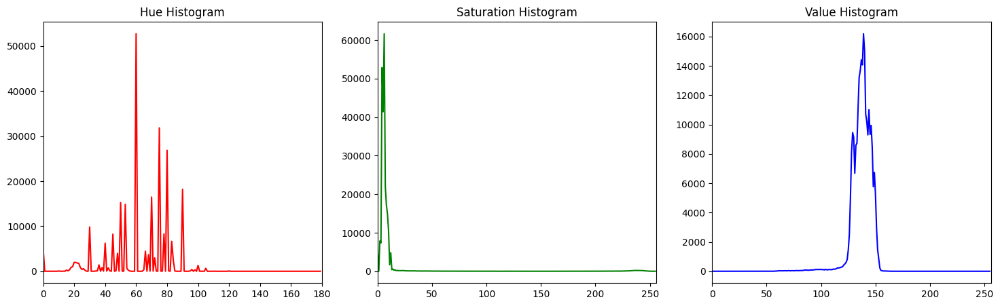

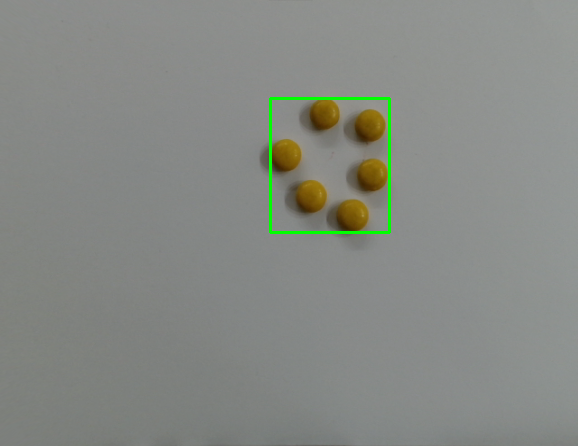

In [53]:
import cv2
import numpy as np
import glob
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt


image_path = glob.glob('./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/*.png')


for item in image_path:


    image = cv2.imread(item)

    image = undistort(image)

    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)


    hue_channel, saturation_channel, value_channel = cv2.split(hsv)


    hue_hist = cv2.calcHist([hue_channel], [0], None, [180], [0, 180])  # 180 bins for hue
    saturation_hist = cv2.calcHist([saturation_channel], [0], None, [256], [0, 256])  # 256 bins for saturation
    value_hist = cv2.calcHist([value_channel], [0], None, [256], [0, 256])  # 256 bins for value


    plt.figure(figsize=(18, 5))

    # hue histogram
    plt.subplot(1, 3, 1)
    plt.plot(hue_hist, color='r')
    plt.title('Hue Histogram')
    plt.xlim([0, 180])

    # saturation histogram
    plt.subplot(1, 3, 2)
    plt.plot(saturation_hist, color='g')
    plt.title('Saturation Histogram')
    plt.xlim([0, 256])

    # value histogram
    plt.subplot(1, 3, 3)
    plt.plot(value_hist, color='b')
    plt.title('Value Histogram')
    plt.xlim([0, 256])

    # Display the histograms
    plt.show()


    # process image
    gray = cv2.cvtColor(hsv, cv2.COLOR_BGR2GRAY)

    blurred = cv2.GaussianBlur(gray, (11, 11), 0)


    edges = cv2.Canny(blurred, 0, 60)

    contours, _ = cv2.findContours(edges.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)



    if contours:

        all_contours = np.vstack(contours)

        # get a bounding rectangle that covers all contours
        x, y, w, h = cv2.boundingRect(all_contours)

        # draw the single ROI around all M&Ms
        output = image.copy()
        cv2.rectangle(output, (x, y), (x + w, y + h), (0, 255, 0), 2)


    cv2_imshow(output)



(c) Determine the average area for the M&Ms in pixels. Show the M&Ms detections

(d) Determine the average area and standard deviation for each M&Ms type (with or without peanut) and color in millimeters. Show the result in a table type vs color vs area and standard deviation.

This code processes images of isolated M&Ms to classify them by type (peanut or regular) and color based on contour detection and color analysis. After loading and undistorting each image, the image is converted to grayscale, blurred, and edges are detected using the Canny edge detector. Contours are identified, and the RGB values within each contour are used to classify the M&Ms' color and determine whether they are regular or peanut based on the contour area. The results, including the type, color, and area in square millimeters, are stored and analyzed in a pandas DataFrame. Finally, a summary table displaying the average area, standard deviation, and count for each M&M type and color is generated.

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/brown_nut.png with average area of 1103.0px


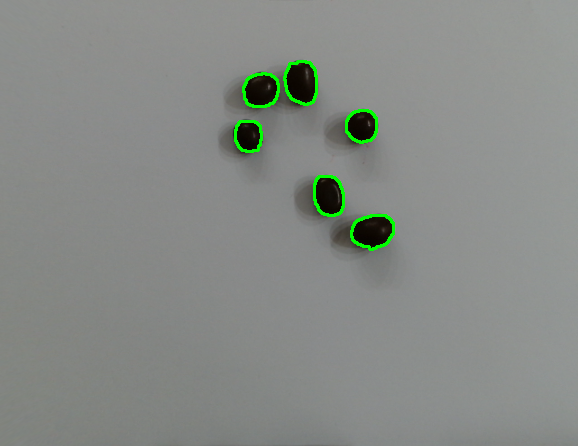

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/blue_nut.png with average area of 1326.5px


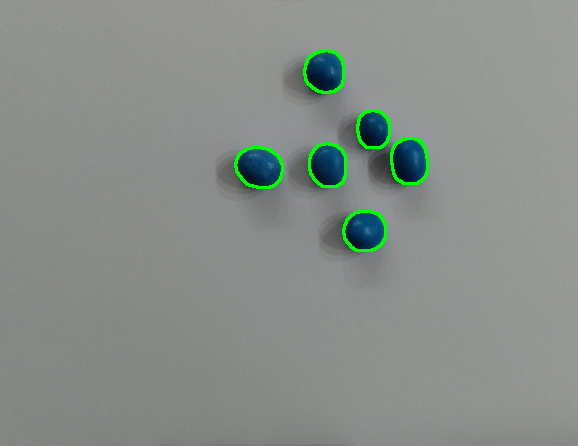

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/red_nut.png with average area of 1283.5px


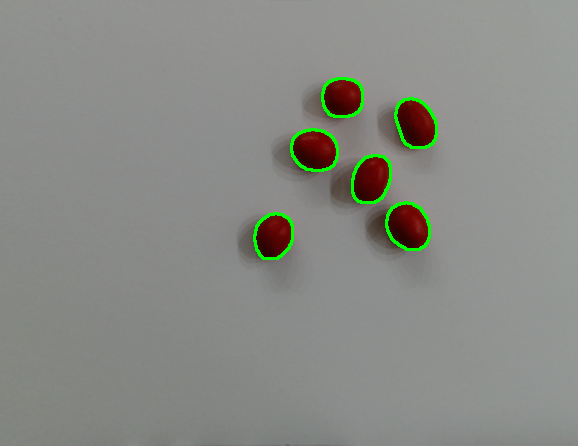

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/blue.png with average area of 883.0px


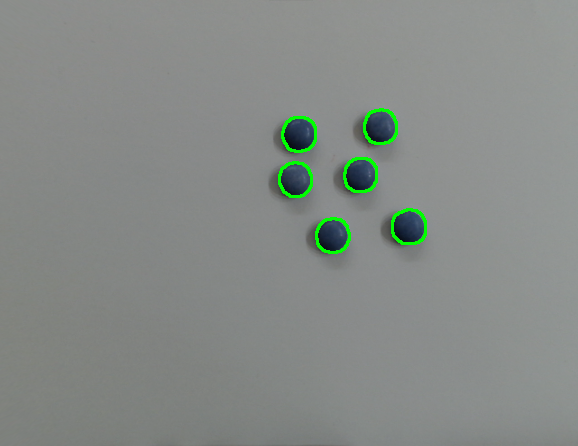

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/yellow_nut.png with average area of 1055.0px


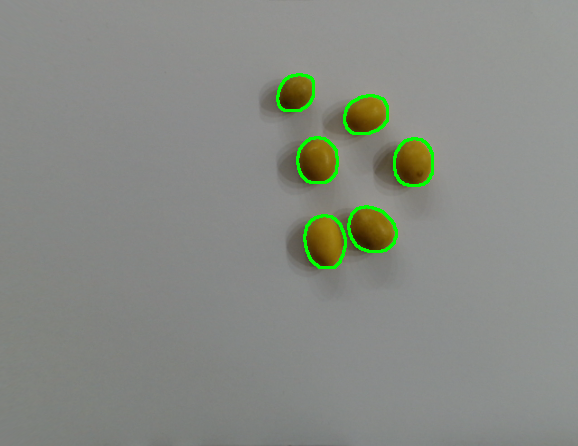

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/green_nut.png with average area of 1594.0px


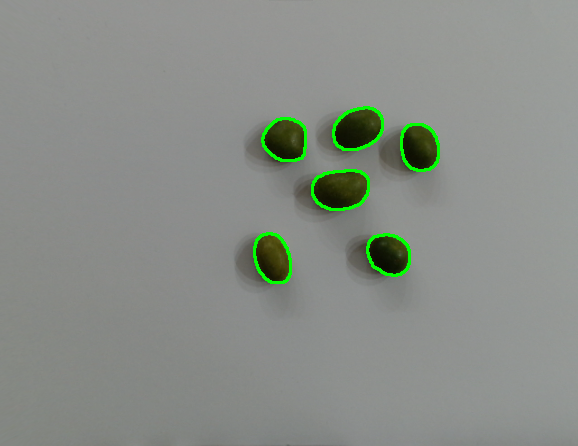

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/green.png with average area of 916.0px


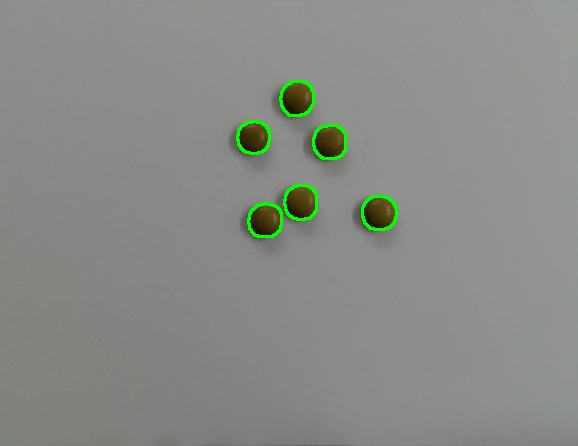

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/red.png with average area of 911.0px


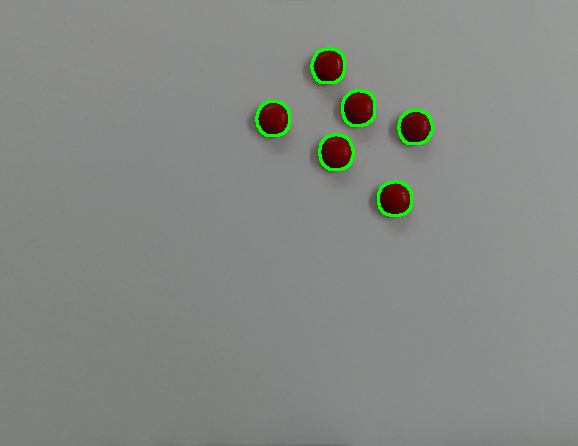

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/brown.png with average area of 843.5px


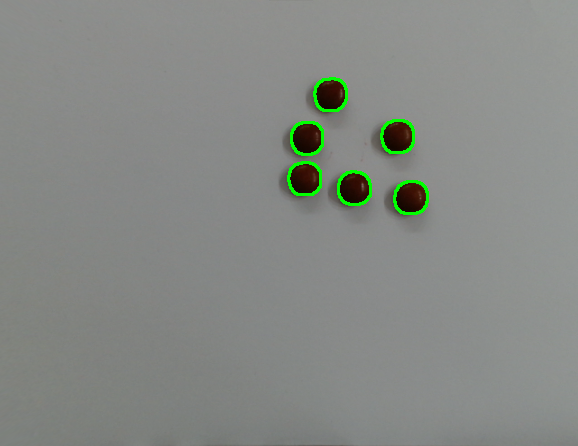

Detections for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/yellow.png with average area of 880.5px


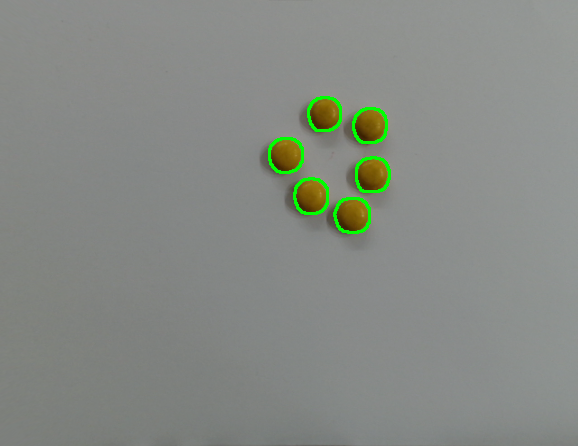

Table with classification of M&M's:
      Type   Color  Average_Area_mm2  Std_Area_mm2  Count
0   Peanut    Blue       9029.205760   1176.567565      6
1   Peanut   Brown       6411.431535   1197.788028      6
2   Peanut   Green      10401.552309   1172.701318      6
3   Peanut     Red      10110.044575    777.419388      6
4   Peanut  Yellow      10035.284142   1618.011313      6
5  Regular    Blue       6232.354220    155.734337      6
6  Regular   Brown       5964.028015     96.449511      6
7  Regular   Green       6206.854537    244.990494      6
8  Regular     Red       6427.079068    125.038514      6
9  Regular  Yellow       6516.907495    226.264970      6


In [49]:
import cv2
import numpy as np
import pandas as pd
import glob
from google.colab.patches import cv2_imshow

image_files = glob.glob('./CV_Assignment/assign1/CV_Assignment/assign1/data/white_isolated/*.png')

area_threshold =1050




pixel_to_mm = 0.3792 # 1 pixel = 0.3792 mm


data = {
    'Type': [],
    'Color': [],
    'Area_mm2': [],
    'Contour_ID': [],
}


def classify_type(area_pixels, color):
  if color!= 'Blue' or color!= 'Brown':
    if area_pixels > area_threshold:
      return 'Peanut'
    else:
      return 'Regular'
  else:
    return ''


def classify_color_rgb(r, g, b):
    if 30 <= r <= 42 and 65 <= g <= 77 and 2 <= b <= 10:
        return 'Brown','Regular'

    elif 11 <= r <= 18 and 59 <= g <= 78 and 1 <= b <= 17:
        return 'Brown','Peanut'

    elif 57 <= r <= 73 and 47 <= g <= 68 and 1 <= b <= 9:
        return 'Red',''

    elif 22 <= r <= 60 and 72 <= g <= 104 and 6 <= b <= 17:
        return 'Green',''

    elif 73 <= r <= 100 and 104 <= g <= 128 and 6 <= b <= 16:
        return 'Yellow',''


    elif 26 <= r <= 42 and 90 <= g <= 110 and 50 <= b <= 82:
        return 'Blue','Regular'

    elif 5 <= r <= 16 and 90 <= g <= 100 and 52 <= b <= 81:
        return 'Blue','Peanut'

    else:
        return 'Unknown'




for image_file in image_files:

    img = cv2.imread(image_file)

    img=undistort(img)

    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)


    gray = cv2.cvtColor(hsv, cv2.COLOR_BGR2GRAY)
    _, bw_image = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)


    blurred = cv2.GaussianBlur(bw_image, (5, 5), 0)

    edges = cv2.Canny(blurred, 0, 60)

    kernel = np.ones((3, 3), np.uint8)
    edges = cv2.dilate(edges, kernel, iterations=2)
    edges = cv2.erode(edges, kernel, iterations=1)


    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    total_area = 0
    m_and_m_count = 0


    for contour in contours:

        if 150 < cv2.contourArea(contour) < 30000:

            cv2.drawContours(img, [contour], -1, (0, 255, 0), 2)

            mask = np.zeros(img.shape[:2], dtype=np.uint8)
            cv2.drawContours(mask, [contour], -1, 255, -1)
            #cv2_imshow(mask)
            sum =+ cv2.contourArea(contour)
            counter =+1

            mean_val = cv2.mean(img, mask=mask)


            avg_blue = mean_val[0]
            avg_green = mean_val[1]
            avg_red = mean_val[2]
            #print(f"For color check last address of path: {image_file}")

            #print(f"Mean RGB for contour at [{x}, {y}, {w}, {h}]: Red={avg_red}, Green={avg_green}, Blue={avg_blue}")

            m_and_m_color = classify_color_rgb(avg_red, avg_green, avg_blue)

            if m_and_m_color[1] != '':
                #print(m_and_m_color)

                area_pixels = cv2.contourArea(contour)

                mask = np.zeros(gray.shape, dtype="uint8")
                cv2.drawContours(mask, [contour], -1, 255, -1)



                area_mm2 = (area_pixels / (pixel_to_mm ** 2))


                data['Type'].append(m_and_m_color[1])
                data['Color'].append(m_and_m_color[0])
                data['Area_mm2'].append(area_mm2)
                data['Contour_ID'].append(counter)
            else:

                area_pixels = cv2.contourArea(contour)
                m_and_m_type = classify_type(area_pixels, m_and_m_color)


                mask = np.zeros(gray.shape, dtype="uint8")
                cv2.drawContours(mask, [contour], -1, 255, -1)


                area_mm2 = (area_pixels / (pixel_to_mm ** 2))


                data['Type'].append(m_and_m_type)
                data['Color'].append(m_and_m_color[0])
                data['Area_mm2'].append(area_mm2)
                data['Contour_ID'].append(counter)

    print(f"Detections for {image_file} with average area of {sum/counter}px")
    cv2_imshow(img)

df = pd.DataFrame(data)

grouped_stats = df.groupby(['Type', 'Color']).agg(
    Average_Area_mm2=('Area_mm2', 'mean'),
    Std_Area_mm2=('Area_mm2', 'std'),
    Count=('Contour_ID', 'size')
).reset_index()

print("Table with classification of M&M's:")

print(grouped_stats)


4. **Consider only the images with the mixed M&Ms retrieved from a white background.
Implement the functions described below.**


(a) Calculate the number of M&M per color and type for all images provided

(b) Show the M&Ms detections and centroids

(c) Provide the table capturing the number of M&Ms type (with or without peanut) and color that are present in each image


This code processes images of mixed M&Ms to classify them by color and type (peanut or regular) based on contour detection and color analysis. First, the image is loaded and undistorted, followed by conversion to HSV and then grayscale for further processing. After applying a Gaussian blur, Canny edge detection is used to identify the edges of the objects in the image. Contours are extracted and filtered based on their area, and for each valid contour, the region of interest (ROI) is analyzed to determine the average RGB values. The color of the M&M is classified using a predefined RGB range, and its type (peanut or regular) is determined based on the contour's area. The code draws a rectangle around the detected M&Ms, labels them by color, and marks their centroid. Finally, the results are displayed in a table, showing the quantity of each M&M type and color.

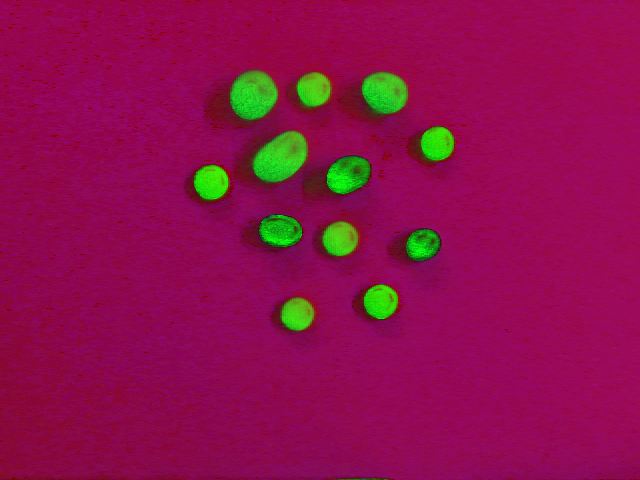

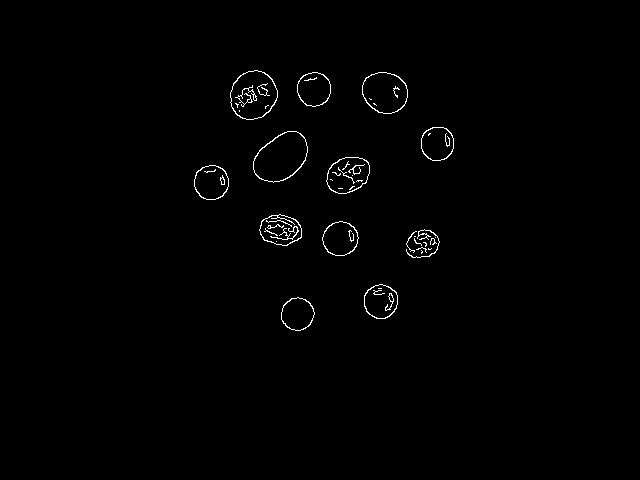

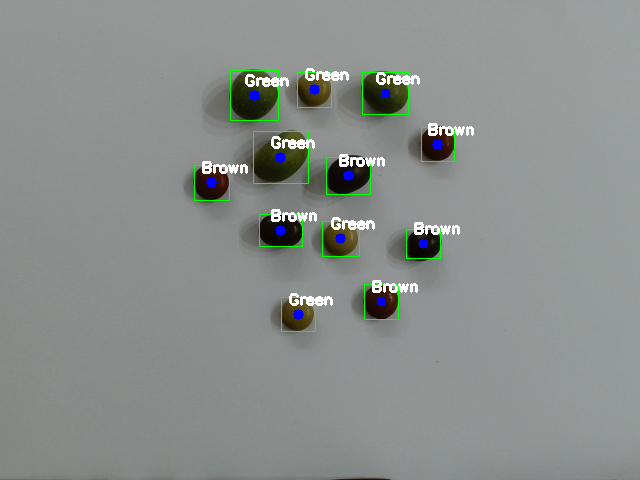

Color and Type Classification for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_mix/green_brown.png:
      Type   Color  Quantity
0   Peanut     Red         0
2   Peanut   Green         3
4   Peanut  Yellow         0
6   Peanut    Blue         0
8   Peanut   Brown         2
1  Regular     Red         0
3  Regular   Green         3
5  Regular  Yellow         0
7  Regular    Blue         0
9  Regular   Brown         4


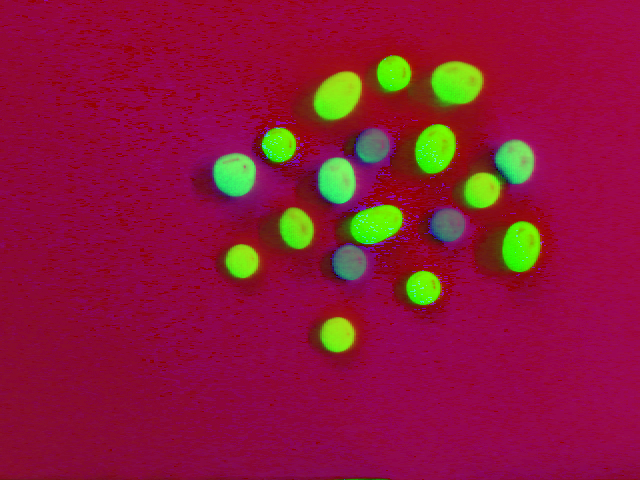

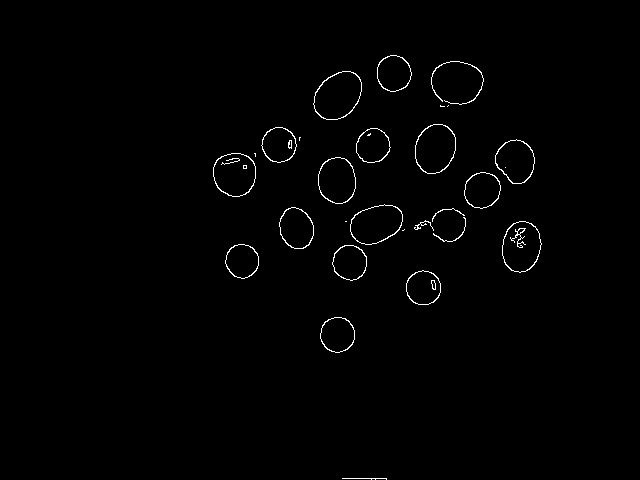

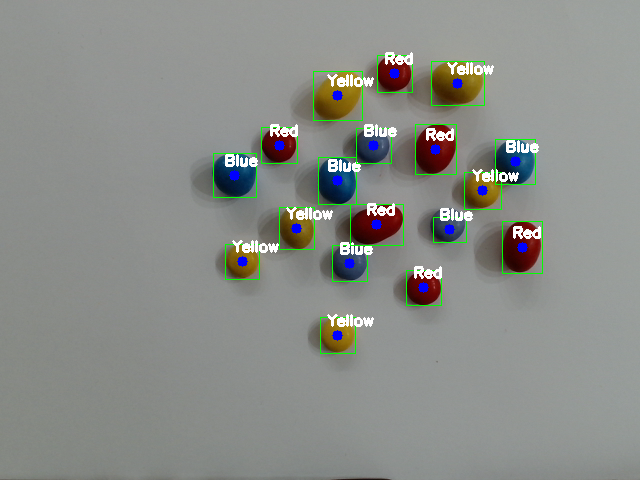

Color and Type Classification for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_mix/blue_yellow_red.png:
      Type   Color  Quantity
0   Peanut     Red         3
2   Peanut   Green         0
4   Peanut  Yellow         3
6   Peanut    Blue         3
8   Peanut   Brown         0
1  Regular     Red         3
3  Regular   Green         0
5  Regular  Yellow         3
7  Regular    Blue         3
9  Regular   Brown         0


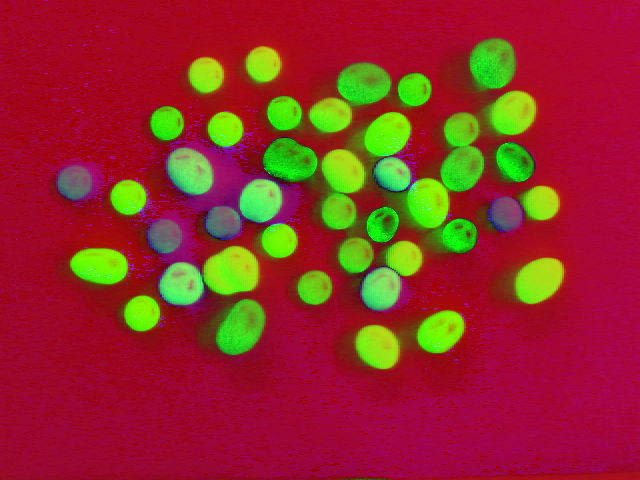

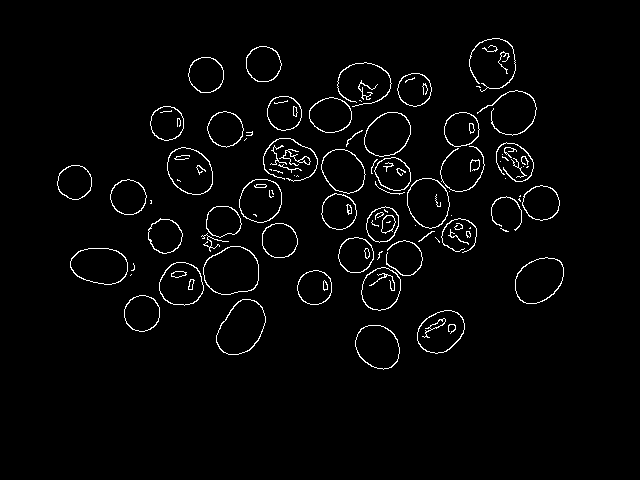

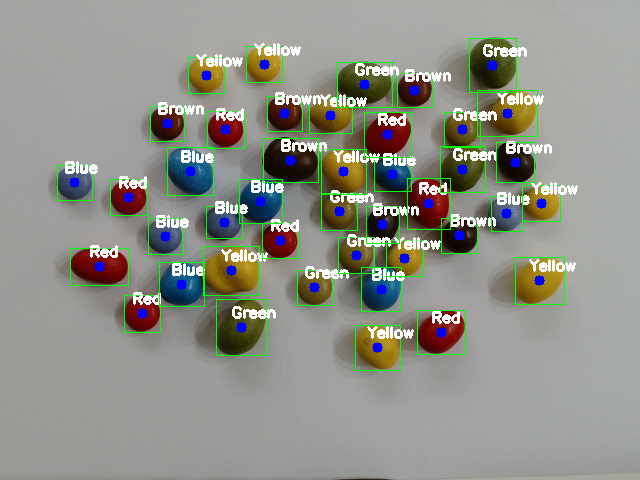

Color and Type Classification for ./CV_Assignment/assign1/CV_Assignment/assign1/data/white_mix/all_rand.png:
      Type   Color  Quantity
0   Peanut     Red         4
2   Peanut   Green         4
4   Peanut  Yellow         6
6   Peanut    Blue         4
8   Peanut   Brown         2
1  Regular     Red         4
3  Regular   Green         4
5  Regular  Yellow         4
7  Regular    Blue         5
9  Regular   Brown         5


In [55]:
import cv2
import numpy as np
import glob
import pandas as pd
from google.colab.patches import cv2_imshow

image_path = glob.glob('./CV_Assignment/assign1/CV_Assignment/assign1/data/white_mix/*.png')

def classify_color_rgb(r, g, b):
    if 9 <= r <= 38 and 27 <= g <= 50 and 26 <= b <= 83:
        return 'Brown'
    elif 18 <= r <= 43 and 21 <= g <= 46 and 92 <= b <= 121:
        return 'Red'
    elif 32 <= r <= 47 and 60 <= g <= 94 and 55 <= b <= 109:
        return 'Green'
    elif 28 <= r <= 53 and 89 <= g <= 170 and 106 <= b <= 159:
        return 'Yellow'
    elif 83 <= r <= 120 and 60 <= g <= 95 and 27 <= b <= 86:
        return 'Blue'
    else:
        return 'Unknown'

for item in image_path:
    color_counts = {
        'Red': {'Peanut': 0, 'Regular': 0},
        'Green': {'Peanut': 0, 'Regular': 0},
        'Yellow': {'Peanut': 0, 'Regular': 0},
        'Blue': {'Peanut': 0, 'Regular': 0},
        'Brown': {'Peanut': 0, 'Regular': 0}
    }

    image = cv2.imread(item)

    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    #cv2_imshow(hsv)

    gray = cv2.cvtColor(hsv, cv2.COLOR_BGR2GRAY)

    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    edges = cv2.Canny(blurred, 0, 70)
    #cv2_imshow(edges)

    contours, _ = cv2.findContours(edges.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    output = image.copy()
    for contour in contours:
        if cv2.contourArea(contour) > 10:
            (x, y, w, h) = cv2.boundingRect(contour)
            if w * h > 800:
                cv2.rectangle(output, (x, y), (x + w, y + h), (0, 255, 0), 1)

                roi = image[y:y+h, x:x+w]

                R, G, B = cv2.split(roi)

                avg_R = np.mean(R)
                avg_G = np.mean(G)
                avg_B = np.mean(B)

                color_label = classify_color_rgb(avg_R, avg_G, avg_B)

                mm_type = 'Peanut' if w * h > 1370 else 'Regular'

                color_counts[color_label][mm_type] += 1

                centroid_x = x + w // 2
                centroid_y = y + h // 2
                cv2.circle(output, (centroid_x, centroid_y), 5, (255, 0, 0), -1)
                cv2.putText(output, color_label, (centroid_x - 10, centroid_y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    cv2_imshow(output)

    data = []
    for color in color_counts:
        for mm_type in color_counts[color]:
            count = color_counts[color][mm_type]
            data.append([mm_type, color, count])

    df = pd.DataFrame(data, columns=['Type', 'Color', 'Quantity'])
    df_sorted = df.sort_values(by='Type', ascending=True)

    print(f"Color and Type Classification for {item}:")
    print(df_sorted)


d) Discuss the limitation of the method implemented (in 2 sentences);

The limitation of the implemented method lies in accurately determining whether an M&M is peanut or regular based solely on its size. Some peanut M&Ms, especially the brown and blue ones, may be detected as smaller than certain regular ones, making it difficult to define a size threshold that consistently distinguishes between the two types.

e) Provide some recommendations that the M&M factory should take into consideration to improve the performance of the sorting process based on image processing
(e.g., imaging setup, calibration process and photometric effects), in 4 sentences.

To improve the sorting process using image processing, the M&M factory should focus on having consistent lighting to avoid shadows and reflections that can mess with color detection.Instead of just relying on size, incorporating more advanced techniques that consider the colors, for instance, using different color of light source to correctly extract all colors, because some colors are very bright and some colors are very dark, what makes it difficult to classify their colors without an appropriate color range. Additionally, adjusting camera settings like exposure and white balance will enhance contrast and make the colors more reliable for detection.

5. **Consider the images retrieved from a brown background and repeat the
previous points (4a, 4b, 4c).**

(a) Calculate the number of M&M per color and type for all images provided.

(b) Show the M&Ms detections and centroids.

(c) Provide the table capturing the number of M&Ms type (with or without peanut) and color that are present in each image.


This code processes images of M&Ms on a brown background, classifying them by color and type (peanut or regular) using contour detection and color analysis. First, each image is converted to the LAB color space, where CLAHE (Contrast Limited Adaptive Histogram Equalization) is applied to enhance the image contrast. After converting the image to grayscale and applying Gaussian blur, Canny edge detection is used to find the edges of the M&Ms. Contours are extracted, and for each valid contour, the RGB color values within the M&M are averaged to classify its color (red, green, yellow, blue, or unknown in case of error). Based on the contour area, the M&M is classified as either peanut or regular, and this information is stored. The code draws bounding boxes and centroids on the detected M&Ms, displaying the labeled results. Finally, the classified data is aggregated into a pandas DataFrame for further analysis, with summary statistics such as the average area for each type and color.








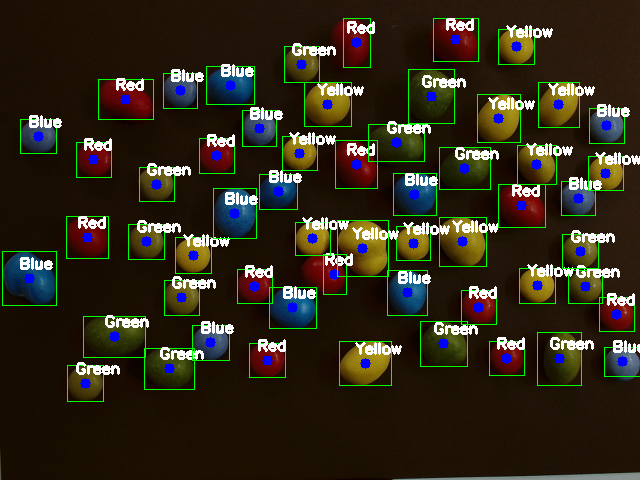

      Type   Color  Average_Area_mm2  Std_Area_mm2  Count
0   Peanut    Blue       2070.500000    434.896654      6
1   Peanut   Green       2248.142857    203.426013      7
2   Peanut     Red       1987.200000    157.954740      5
3   Peanut  Yellow       2135.000000    416.753324      7
4  Regular    Blue       1211.000000     87.100927      8
5  Regular   Green       1225.285714     56.753015      7
6  Regular     Red       1186.333333    108.440076      9
7  Regular  Yellow       1215.285714     56.186340      7
Red: 14, Green: 14, Yellow: 14, Blue: 14, Counting erros: 0 M&Ms not counted
Peanut: 25, Regular: 31, Sizing errors: 3.0 M&Ms dont correspond to their type


In [51]:
import cv2
import numpy as np
import glob
import pandas as pd
from google.colab.patches import cv2_imshow

image_path = glob.glob('./CV_Assignment/assign1/CV_Assignment/assign1/data/brown_mix/*.png')

mm_data = []

red_count = 0
green_count = 0
yellow_count = 0
blue_count = 0
unknown_count = 0

peanut_count = 0
regular_count = 0

def classify_color_rgb_brownbg(r, g, b):
    if 2 <= r <= 8 and 6 <= g <= 14 and 70 <= b <= 91:
        return 'Red'
    elif 2 <= r <= 20 and 39 <= g <= 70 and 37 <= b <= 80:
        return 'Green'
    elif 9 <= r <= 16 and 63 <= g <= 91 and 82 <= b <= 129:
        return 'Yellow'
    elif 60 <= r <= 84 and 40 <= g <= 70 and 10 <= b <= 60:
        return 'Blue'
    else:
        return 'Unknown'

for item in image_path:
    image = cv2.imread(item)

    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    enhanced_image = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

    gray = cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    edges = cv2.Canny(blurred, 0, 80)

    contours, _ = cv2.findContours(edges.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    output = image.copy()

    for contour in contours:
        if cv2.contourArea(contour) > 3:
            (x, y, w, h) = cv2.boundingRect(contour)
            area = w * h
            if area > 800:
                roi = image[y:y+h, x:x+w]
                R, G, B = cv2.split(roi)
                avg_R = np.mean(R)
                avg_G = np.mean(G)
                avg_B = np.mean(B)
                color_label = classify_color_rgb_brownbg(avg_R, avg_G, avg_B)

                if color_label == 'Red':
                    red_count += 1
                elif color_label == 'Green':
                    green_count += 1
                elif color_label == 'Yellow':
                    yellow_count += 1
                elif color_label == 'Blue':
                    blue_count += 1
                else:
                    unknown_count += 1

                mm_type = 'Peanut' if area > 1370 else 'Regular'
                if mm_type == 'Peanut':
                    peanut_count += 1
                else:
                    regular_count += 1

                mm_data.append({
                    'Type': mm_type,
                    'Color': color_label,
                    'Area': area
                })

                cv2.rectangle(output, (x, y), (x + w, y + h), (0, 255, 0), 1)

                centroid_x = x + w // 2
                centroid_y = y + h // 2
                cv2.circle(output, (centroid_x, centroid_y), 5, (255, 0, 0), -1)
                cv2.putText(output, color_label, (centroid_x - 10, centroid_y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    cv2_imshow(output)

df = pd.DataFrame(mm_data)

grouped_stats = df.groupby(['Type', 'Color']).agg(
    Average_Area_mm2=('Area', 'mean'),
    Std_Area_mm2=('Area', 'std'),
    Count=('Area', 'size')
).reset_index()

count_list = grouped_stats['Count'].tolist()

print(grouped_stats)

print(f"Red: {red_count}, Green: {green_count}, Yellow: {yellow_count}, Blue: {blue_count}, Counting erros: {unknown_count} M&Ms not counted")
print(f"Peanut: {peanut_count}, Regular: {regular_count}, Sizing errors: {0.5*(abs(count_list[0] - 7) + abs(count_list[1] - 7) + abs(count_list[2]-7) + abs(count_list[3]-7) + abs(count_list[4]-7) + abs(count_list[5]-7) + abs(count_list[6]-7) + abs(count_list[7] - 7))} M&Ms dont correspond to their type")
